In [25]:
import polars as pl
import numpy as np
import matplotlib.pyplot as plt
import os

[ 1.14528334 -1.19330478  0.32370704 ... -1.12812316 -0.01900196
 -0.17146681]


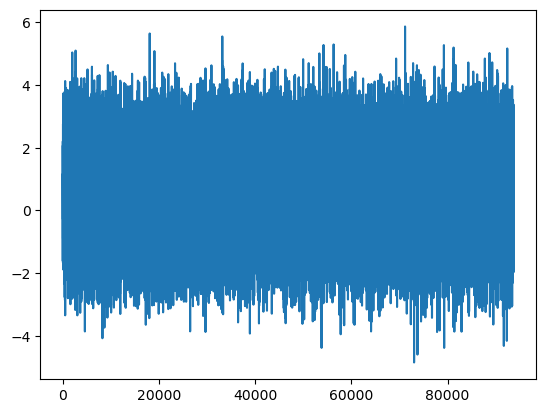

In [24]:
c1 = np.loadtxt('./dataset/txt/T0001.txt')

c1mean = np.mean(c1)
plt.plot(range(0,c1.shape[0]),c1)
print(c1)

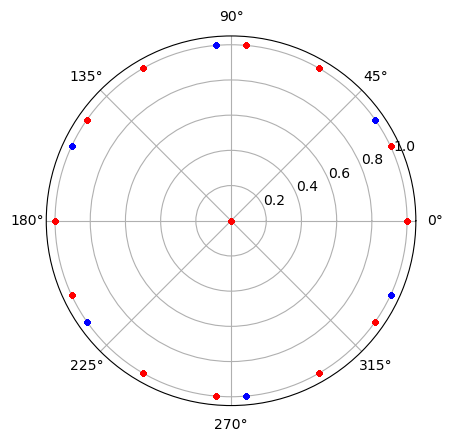

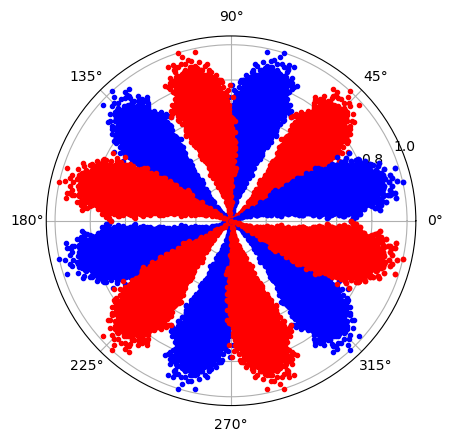

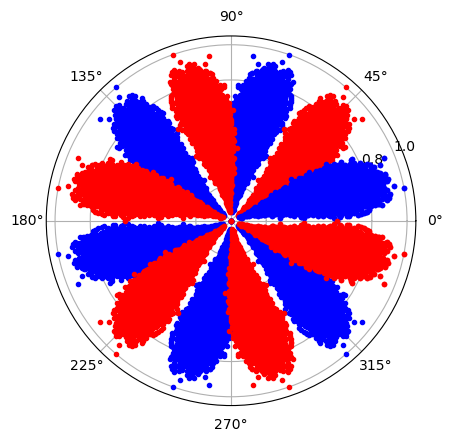

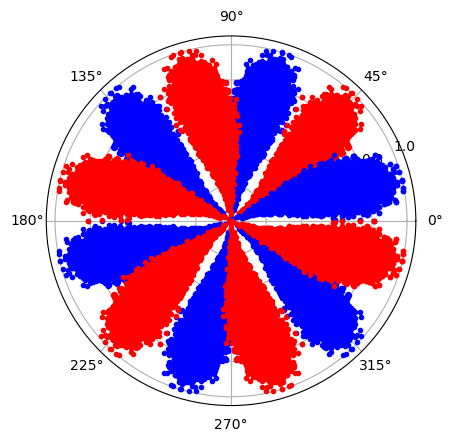

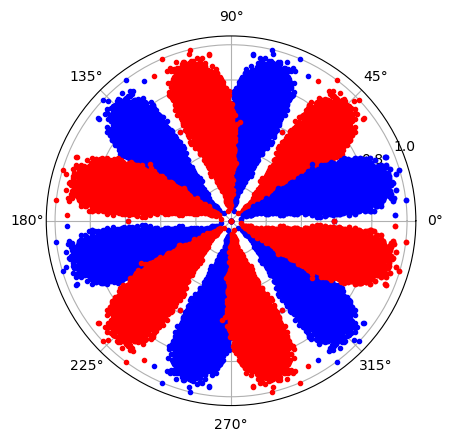

...

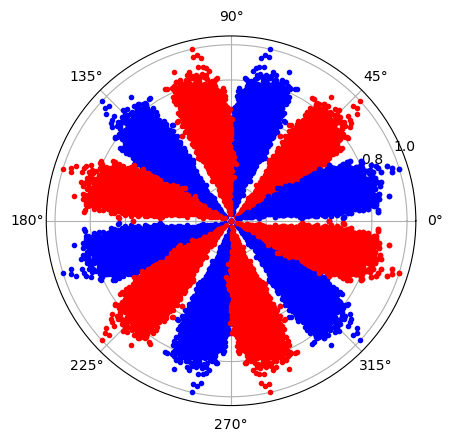

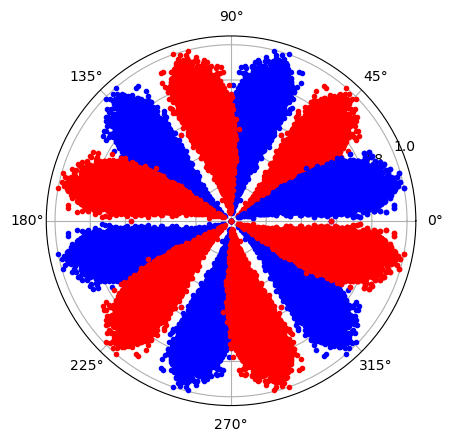

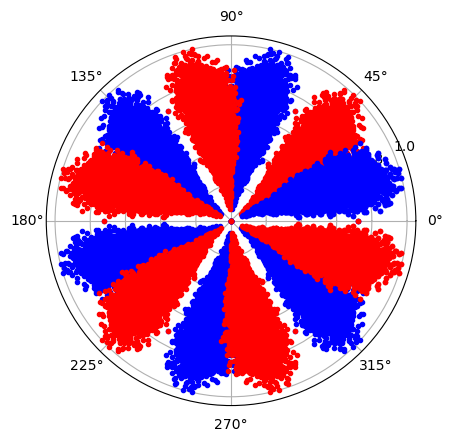

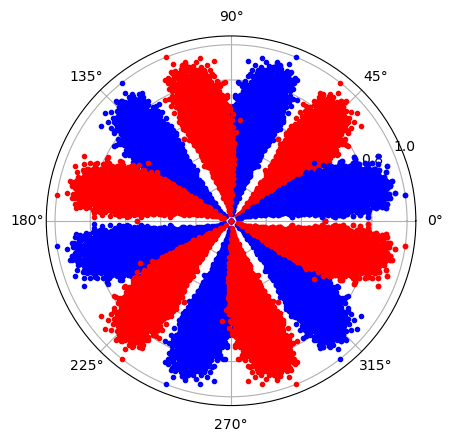

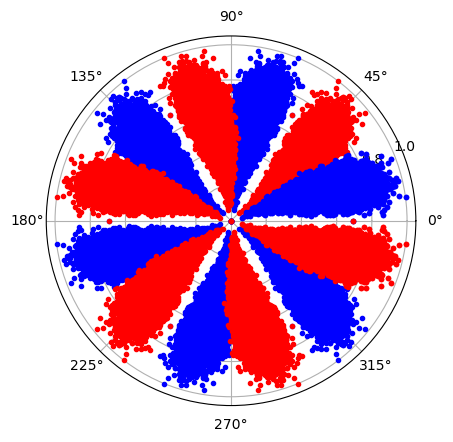

KeyboardInterrupt: 

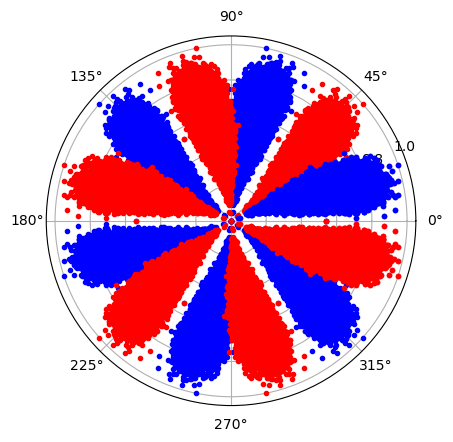

In [27]:
directory = './dataset/txt/'
directory_png = './dataset/png/'

for filename in os.listdir(directory):
    if filename.endswith('.txt'):
        c1 = np.loadtxt(os.path.join(directory, filename))

        c1mean = np.mean(c1)
        c1 = (c1 - c1mean) / max(abs(c1 - c1mean))
        c1max = np.max(c1)
        c1min = np.min(c1)

        z = 35
        t = 2

        plt.figure()

        for i in range(0, 7):
            r = ((c1 - c1min) / (c1max - c1min))
            r = r[:len(c1) - t]
            theta = (60 * i + (((c1 - c1min) / (c1max - c1min)) * z))
            phi = (60 * i - (((c1 - c1min) / (c1max - c1min)) * z))
            theta = theta[t:]
            phi = phi[t:]

            plt.polar(theta * (np.pi / 180), r, '.', c='blue')
            plt.polar(phi * (np.pi / 180), r, '.', c='red')

        plot_filename = os.path.splitext(filename)[0] + '_polar_plot.png'
        plt.savefig(os.path.join(directory_png, plot_filename), format='png')
        
        plt.show()

In [19]:
cslice = c1[:2002]

xmax = np.max(cslice)
xmin = np.min(cslice)
xmean = np.mean(cslice)
x = cslice

print(xmax,xmin,xmean)

0.8273988729279392 -0.7220941121513447 0.0012595764105145274


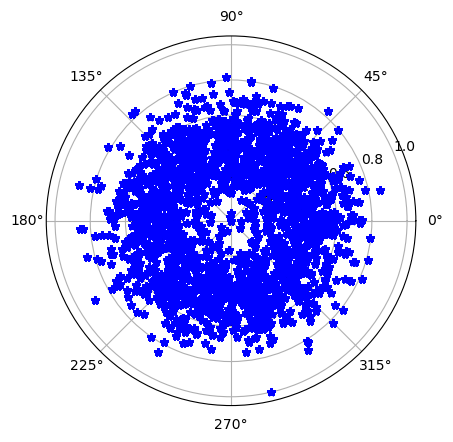

In [22]:
r = []
theta = []
phi = []
angle = 1
fig  = plt.figure()
for i in range(0,2000):
  xi = x[i]
  r.append(((xi-xmin)/(xmax-xmin)))
  theta.append(angle*60 + (((x[i+t]-xmin)/(xmax-xmin))*z))
  phi.append(angle*60 - (((x[i+t]-xmin)/(xmax-xmin))*z))
  
  plt.polar(theta,r,'*', c='blue')
plt.show() 


In [23]:
!nvidia-smi

Sun Oct 27 19:58:04 2024       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 560.94                 Driver Version: 560.94         CUDA Version: 12.6     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                  Driver-Model | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce GTX 1650      WDDM  |   00000000:01:00.0 Off |                  N/A |
| N/A   41C    P8              4W /   30W |       0MiB /   4096MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----